## Визуализация лосса

In [7]:
import os
import numpy as np

In [8]:
val_losses = np.loadtxt('val_losses.txt')

In [9]:
n_epochs = len(val_losses)
epoch_ends = []
cur_pos = 0
for epoch in range(n_epochs):
    epoch_losses = np.loadtxt('losses_on_epoch{}.txt'.format(epoch + 1))
    if epoch == 0:
        train_losses = epoch_losses
    else:
        train_losses = np.concatenate([train_losses, epoch_losses])
    cur_pos += len(epoch_losses)
    epoch_ends.append(cur_pos)

In [10]:
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
def running_mean(x, n):
    cumsum = np.cumsum(x)
    return (cumsum[n:] - cumsum[:-n]) / n

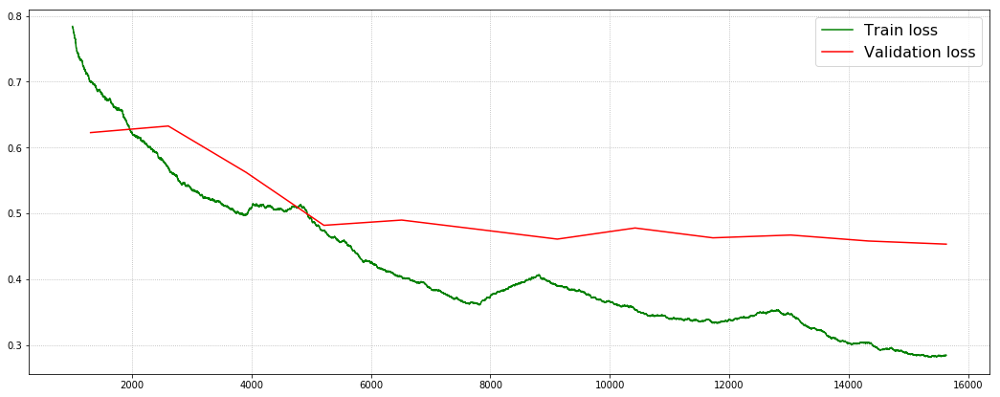

In [12]:
plt.figure(figsize=(18, 7))
plt.grid(ls=':')
plt.plot(np.arange(1000, len(train_losses)), running_mean(train_losses, 1000), color='g', label='Train loss')
plt.plot(epoch_ends, val_losses, color='r', label='Validation loss')
plt.legend(fontsize=16)

## Визуализация предсказаний

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [2]:
import h5py
train_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/train_data_fullsize_small.hdf5', 'r')
rgbs_train = train_data_file['data']
depths_train = train_data_file['label']
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = val_data_file['data']
depths_val = val_data_file['label']
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = test_data_file['data']
depths_test = test_data_file['label']

In [3]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
import tensorflow as tf

In [5]:
%%time
from keras.models import load_model
model = load_model('model_on_epoch10.hdf5')

Using TensorFlow backend.


CPU times: user 40.1 s, sys: 10.8 s, total: 50.9 s
Wall time: 44 s


In [6]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 384, 512, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 390, 518, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 192, 256, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 192, 256, 64) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

### Обучающая выборка

In [7]:
rgbs_train_sample = np.array(rgbs_train[::1000])
depths_train_sample = np.array(depths_train[::1000])

In [8]:
train_prediction = model.predict(rgbs_train_sample, batch_size=32)

In [9]:
sq_diff = (train_prediction - depths_train_sample) ** 2

In [10]:
print('train MSE:', np.mean((train_prediction - depths_train_sample) ** 2))

train MSE: 0.21198873603269047


In [11]:
print('train rel error:', np.mean(np.abs(train_prediction - depths_train_sample) / np.maximum(depths_train_sample, 0.5)))

train rel error: 0.12453427745968668


In [12]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

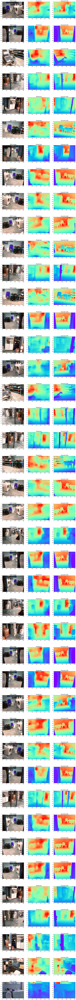

In [13]:
n = len(rgbs_train_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_train_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_train_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(train_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_train_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: те же коллекции, другие сцены

In [14]:
rgbs_val_sample = np.array(rgbs_val)
depths_val_sample = np.array(depths_val)

In [15]:
%%time
val_prediction = model.predict(rgbs_val_sample, batch_size=32)

CPU times: user 2min 23s, sys: 33.5 s, total: 2min 56s
Wall time: 2min 53s


In [16]:
sq_diff = (val_prediction - depths_val_sample) ** 2

In [17]:
sq_diff.shape

(14266, 384, 512)

Изучим ошибку на объектах разной дальности

In [18]:
error = (val_prediction - depths_val_sample) ** 2
relative_error = np.abs(val_prediction - depths_val_sample) / np.maximum(depths_val_sample, 0.5)
target_pixels = (depths_val_sample < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val_sample > 1, depths_val_sample < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val_sample > 2, depths_val_sample < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_val_sample > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.47025935477741876
Relative_error: 0.6198069849135887


On objects with depth between 1m and 2m:
MSE: 0.20929303568897858
Relative_error: 0.21800520378681457


On objects with depth between 2m and 5m:
MSE: 0.27705034091424746
Relative_error: 0.1315077739350732


On objects with depth > 5m:
MSE: 2.2303477002212926
Relative_error: 0.1627693877846455




In [19]:
print('Validation depth sample contains:')
print('Depths < 1m: {}%'.format(np.round((depths_val_sample < 1).mean() * 100, 1)))
target_depths = np.logical_and(depths_val_sample > 1, depths_val_sample < 2)
print('Depths between 1m and 2m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
target_depths = np.logical_and(depths_val_sample > 2, depths_val_sample < 5)
print('Depths between 2m and 5m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
print('Depths > 5m: {}%'.format(np.round((depths_val_sample > 5).mean() * 100, 1)))

Validation depth sample contains:
Depths < 1m: 4.1%
Depths between 1m and 2m: 36.6%
Depths between 2m and 5m: 48.7%
Depths > 5m: 10.6%


In [20]:
print('validation MSE:', np.mean((val_prediction - depths_val_sample) ** 2))
print('Validation relative error:', np.mean(np.abs(val_prediction - depths_val_sample) / np.maximum(depths_val_sample, 0.5)))

validation MSE: 0.46710377953099674
Validation relative error: 0.18656089324409433


In [21]:
val_prediction = np.maximum(val_prediction, 0.5)
depths_val_sample = np.maximum(depths_val_sample, 0.5)
rel_error = np.maximum(val_prediction / depths_val_sample, depths_val_sample / val_prediction)
print('val delta_1:', np.mean(rel_error < 1.25))
print('val delta_2:', np.mean(rel_error < 1.25 ** 2))
print('val delta_3:', np.mean(rel_error < 1.25 ** 3))

val delta_1: 0.7184710891019842
val delta_2: 0.9286831309792148
val delta_3: 0.9802189387586151


In [22]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [23]:
rgbs_val_sample = rgbs_val_sample[::534]
depths_val_sample = depths_val_sample[::534]
val_prediction_sample = val_prediction[::534]

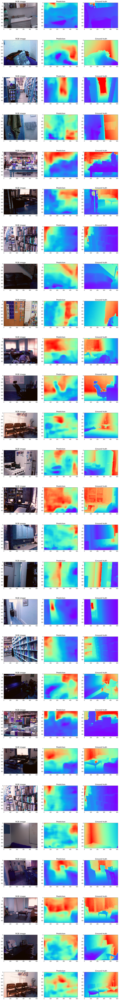

In [24]:
n = len(rgbs_val_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_val_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: другие коллекции

In [25]:
for layer in model.layers:
    if layer.name.startswith('my_batch'):
        K.set_value(layer._trainable_tensor, 0)

In [26]:
model.build(input_shape=(384, 512, 3))

In [27]:
rgbs_test_sample = np.array(rgbs_test)
depths_test_sample = np.array(depths_test)

In [28]:
model.compile(optimizer='adam', loss='mse')

In [29]:
import keras.backend as K
sess = K.get_session()

In [30]:
%%time
test_prediction = model.predict(rgbs_test_sample, batch_size=1)

CPU times: user 1min 15s, sys: 1min 16s, total: 2min 32s
Wall time: 2min 20s


In [31]:
print('second-validation MSE:', np.mean((test_prediction - depths_test_sample) ** 2))

second-validation MSE: 0.7904477786527412


In [32]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [33]:
rgbs_test_sample = rgbs_test_sample[::100]
depths_test_sample = depths_test_sample[::100]
test_prediction_sample = test_prediction[::100]

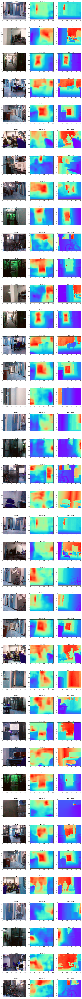

In [34]:
n = len(rgbs_test_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_test_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(test_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

### Изучение ошибки на объектах разной дальности

In [35]:
rgbs_test_sample = np.array(rgbs_test)
depths_test_sample = np.array(depths_test)

In [36]:
test_prediction =  model.predict(rgbs_test_sample)

In [37]:
sq_diff = (test_prediction - depths_test_sample) ** 2

In [38]:
error = (test_prediction - depths_test_sample) ** 2
relative_error = np.abs(test_prediction - depths_test_sample) / np.maximum(depths_test_sample, 0.5)
target_pixels = (depths_test_sample < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test_sample > 1, depths_test_sample < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test_sample > 2, depths_test_sample < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_test_sample > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.5672899082751093
Relative_error: 0.7678317863972471


On objects with depth between 1m and 2m:
MSE: 0.45820161822358135
Relative_error: 0.34093641234924493


On objects with depth between 2m and 5m:
MSE: 0.4368607161071966
Relative_error: 0.16714633953553165


On objects with depth > 5m:
MSE: 2.9472056292932196
Relative_error: 0.19973759908255992




In [39]:
print('Test MSE:', np.mean((test_prediction - depths_test_sample) ** 2))
print('Test relative error:', np.mean(np.abs(test_prediction - depths_test_sample) / np.maximum(depths_test_sample, 0.5)))

Test MSE: 0.7904474939328069
Test relative error: 0.24709582585448453


In [40]:
test_prediction = np.maximum(test_prediction, 0.5)
depths_test_sample = np.maximum(depths_test_sample, 0.5)
rel_error = np.maximum(test_prediction / depths_test_sample, depths_test_sample / test_prediction)
print('Test delta_1:', np.mean(rel_error < 1.25))
print('Test delta_2:', np.mean(rel_error < 1.25 ** 2))
print('Test delta_3:', np.mean(rel_error < 1.25 ** 3))

Test delta_1: 0.6160469990297418
Test delta_2: 0.8697522025369157
Test delta_3: 0.9571210629422346


In [41]:
print('Depths sample contains:')
print('Depths < 1m: {}%'.format(np.round((depths_test_sample < 1).mean() * 100, 1)))
target_depths = np.logical_and(depths_test_sample > 1, depths_test_sample < 2)
print('Depths between 1m and 2m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
target_depths = np.logical_and(depths_test_sample > 2, depths_test_sample < 5)
print('Depths between 2m and 5m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
print('Depths > 5m: {}%'.format(np.round((depths_test_sample > 5).mean() * 100, 1)))

Depths sample contains:
Depths < 1m: 5.3%
Depths between 1m and 2m: 25.2%
Depths between 2m and 5m: 55.9%
Depths > 5m: 13.6%


In [42]:
depths_test_sample[depths_test_sample < 0.5] = 0.5
print('MSE between logs:', np.mean((np.log(test_prediction) - np.log(depths_test_sample)) ** 2))

MSE between logs: 0.09220093988045819
